2. What is the average height of the players?

Getting the data from home team and away team.

In [1]:
import pandas as pd
from pathlib import Path

useful_columns = [
    'height',
    'player_id',
    'match_id',
    'country'
]

folder_path = Path('../data/input/raw_match_parquet')

# home team

all_home_team_dfs = []

for parquet_file in folder_path.glob('home_team_*.parquet'):
    try:
        df = pd.read_parquet(parquet_file, columns=useful_columns)
        all_home_team_dfs.append(df)
        print(f"Successfully read {parquet_file.name}")
    except Exception as e:
        print(f"Error reading {parquet_file.name}: {e}")

if all_home_team_dfs:
    home_team_data = pd.concat(all_home_team_dfs, ignore_index=True)
    print("\n--- Combined Home Team DataFrame Info ---")
    print(home_team_data.shape)
    print(home_team_data.head())
    print(f"Successfully combined {len(all_home_team_dfs)} home team parquet files.")
else:
    print(f"No 'home_team_*.parquet' files found in {folder_path} or no files could be read.")



#away team

all_away_team_dfs = []

for parquet_file in folder_path.glob('away_team_*.parquet'):
    try:
        df = pd.read_parquet(parquet_file, columns=useful_columns)
        all_away_team_dfs.append(df)
        print(f"Successfully read {parquet_file.name}")
    except Exception as e:
        print(f"Error reading {parquet_file.name}: {e}")

if all_away_team_dfs:
    away_team_data = pd.concat(all_away_team_dfs, ignore_index=True)
    print("\n--- Combined Home Team DataFrame Info ---")
    print(away_team_data.shape)
    print(away_team_data.head())
    print(f"Successfully combined {len(all_away_team_dfs)} home team parquet files.")
else:
    print(f"No 'home_team_*.parquet' files found in {folder_path} or no files could be read.")


Successfully read home_team_11998445.parquet
Successfully read home_team_11998446.parquet
Successfully read home_team_11998447.parquet
Successfully read home_team_11998448.parquet
Successfully read home_team_11998449.parquet
Successfully read home_team_11998450.parquet
Successfully read home_team_11998451.parquet
Successfully read home_team_11998452.parquet
Successfully read home_team_11998453.parquet
Successfully read home_team_11998454.parquet
Successfully read home_team_11998455.parquet
Successfully read home_team_11998456.parquet
Successfully read home_team_11998457.parquet
Successfully read home_team_11998458.parquet
Successfully read home_team_11998459.parquet
Successfully read home_team_11998663.parquet
Successfully read home_team_11998664.parquet
Successfully read home_team_11998666.parquet
Successfully read home_team_11998667.parquet
Successfully read home_team_11998670.parquet
Successfully read home_team_11998671.parquet
Successfully read home_team_11998672.parquet
Successful

C:\Users\Parsan Afzar\AppData\Local\Temp\ipykernel_10868\3645066239.py:26: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  home_team_data = pd.concat(all_home_team_dfs, ignore_index=True)



--- Combined Home Team DataFrame Info ---
(12389, 4)
   height  player_id  match_id  country
0    1.83     287803  11998445   France
1    1.80      62790  11998446   France
2    1.88      64580  11998447  Croatia
3    1.88     131442  11998448      USA
4    1.96      22218  11998449   France
Successfully combined 12389 home team parquet files.
Successfully read away_team_11998445.parquet
Successfully read away_team_11998446.parquet
Successfully read away_team_11998447.parquet
Successfully read away_team_11998448.parquet
Successfully read away_team_11998449.parquet
Successfully read away_team_11998450.parquet
Successfully read away_team_11998451.parquet
Successfully read away_team_11998452.parquet
Successfully read away_team_11998453.parquet
Successfully read away_team_11998454.parquet
Successfully read away_team_11998455.parquet
Successfully read away_team_11998456.parquet
Successfully read away_team_11998457.parquet
Successfully read away_team_11998458.parquet
Successfully read away_

C:\Users\Parsan Afzar\AppData\Local\Temp\ipykernel_10868\3645066239.py:49: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  away_team_data = pd.concat(all_away_team_dfs, ignore_index=True)


Importing other libraries we need.

In [2]:
import matplotlib.pyplot as plt
import seaborn as sns

Combining home and away team.

In [3]:
if not home_team_data.empty and not away_team_data.empty:
    all_players_data = pd.concat([home_team_data, away_team_data], ignore_index=True)
    print(all_players_data.shape)
    print(all_players_data.head())
elif not home_team_data.empty:
    all_players_data = home_team_data.copy()
    print(all_players_data.shape)
    print(all_players_data.head())
elif not away_team_data.empty:
    all_players_data = away_team_data.copy()
    print(all_players_data.shape)
    print(all_players_data.head())
else:
    all_players_data = pd.DataFrame(columns=useful_columns)

(24079, 4)
   height  player_id  match_id  country
0    1.83     287803  11998445   France
1    1.80      62790  11998446   France
2    1.88      64580  11998447  Croatia
3    1.88     131442  11998448      USA
4    1.96      22218  11998449   France


Making sure the culumn we need exists.

In [4]:
if 'height' not in all_players_data.columns:
    print("The height column was not found!")
    exit()

Getting the median and replace it to our NaN values.

In [18]:
median_height = all_players_data['height'].median()
all_players_data['height'] =  all_players_data['height'].fillna(median_height)
print(median_height)


1.83


Finding the Arithmetic Mean:

In [17]:
if not all_players_data['height'].empty:
    arithmetic_avg_height = all_players_data['height'].mean()
    print(f"Arithmetic Average of Height: {arithmetic_avg_height: .2f}")
else:
    print("Can not calculate the arithmetic average")

Arithmetic Average of Height:  1.82


Finding the Mode:

In [25]:
if not all_players_data['height'].empty:
    mode_height = all_players_data['height'].mode()
    print("Mode of height:")
    if isinstance(mode_height, pd.Series):
        for mode in mode_height:
            print(f"{mode}")
    else:
        print(f"{mode_height}")
else:
    print("Can not calculate the mode")

Mode of height:
1.85


Visualizing the Data:

In [ ]:
if not all_player_data['height'].empty:
    plt.figure(figsize=(10, 6))
    sns.histplot(all_player_data['height'], kde=True, bins=20)
    plt.axvline(arithmetic_avg_height, color='red', linestyle='dashed', linewidth=2, label=f'Mean: {arithmetic_avg_height:.2f}')
    if not mode_height.empty: 
        for i, mode_val in enumerate(mode_height):
            plt.axvline(mode_val, color='green', linestyle='dotted', linewidth=2, label=f'Mode{"" if len(mode_height) == 1 else f" {i+1}"}: {mode_val}')
    plt.title('Distribution of Player Heights')
    plt.xlabel('Height')
    plt.ylabel('Frequency')
    plt.legend()
    plt.grid(axis='y', alpha=0.75)
    plt.show()
else:
    print("\n3. Cannot visualize height distribution: No valid height data after cleaning.")

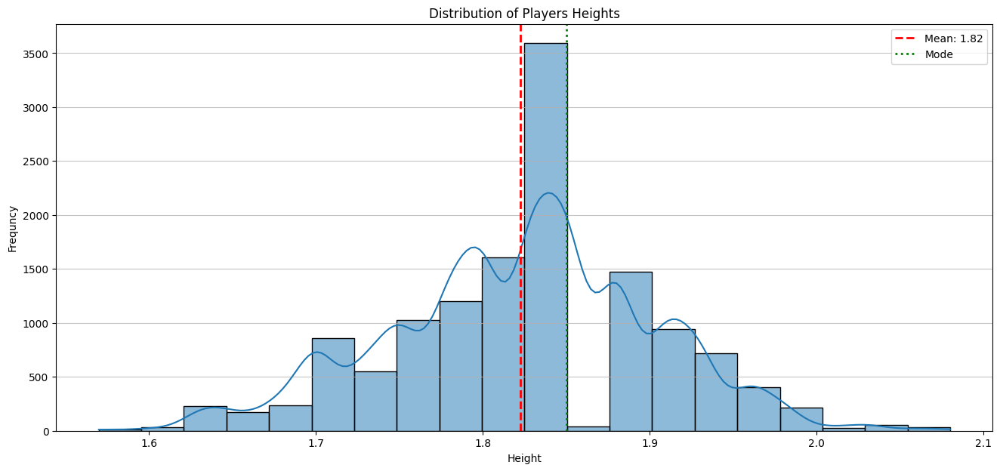

In [39]:
if not all_players_data['height'].empty:
    plt.figure(figsize=(16, 7))
    sns.histplot(all_players_data['height'], kde = True, bins=20)
    plt.axvline(arithmetic_avg_height, color='red', linestyle = 'dashed', linewidth = 2, label = f'Mean: {arithmetic_avg_height:.2f}')
    if not mode_height.empty:
        for i, mode_val in enumerate(mode_height):
            plt.axvline(mode_val, color = 'green', linestyle = 'dotted', linewidth = 2, label = f'Mode{""if len(mode_height) == 1 else f" {i+1}: {mode_val}"}')
    plt.title('Distribution of Players Heights')
    plt.xlabel('Height')
    plt.ylabel('Frequncy')
    plt.legend()
    plt.grid(axis='y', alpha=0.75)

    # Saving the output as jpg.
    output_directory = Path('../data/output')
    file_name = "Distribution of Players Heights.png" 

    full_path = output_directory / file_name

    plt.savefig(full_path, dpi=300)
    
    plt.show()
else:
    print("Can not visualize height distribution")

Extra: Visualizing by Country.

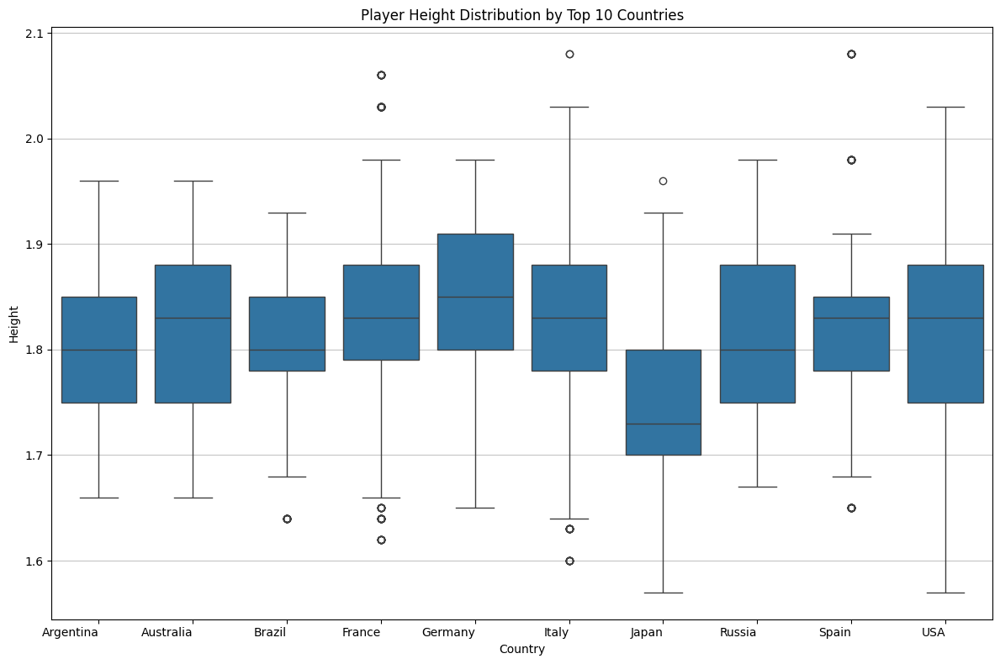

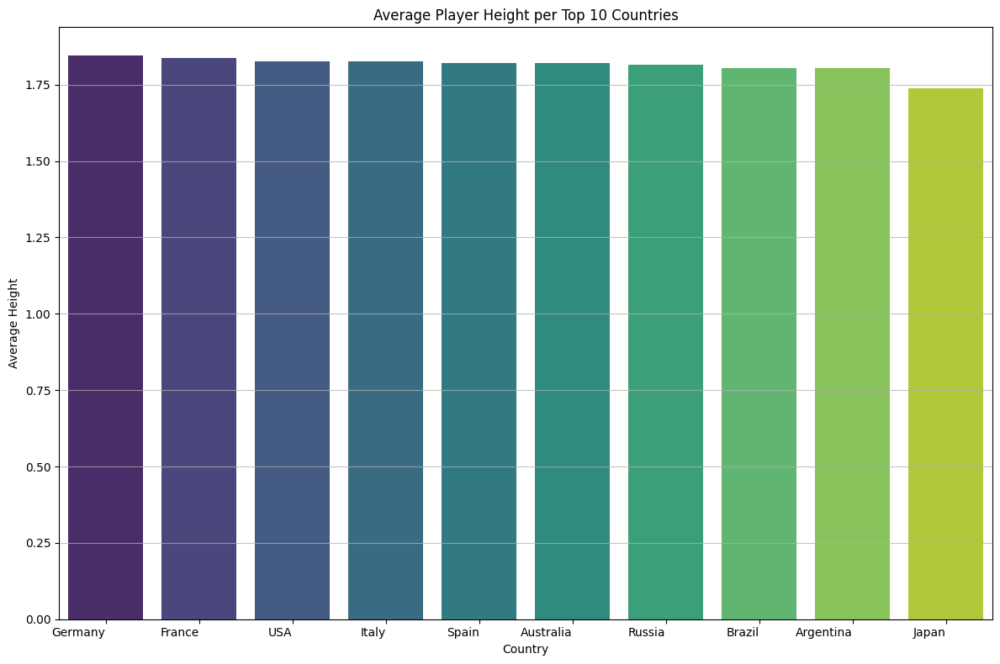

In [ ]:
if not all_players_data.empty and 'country' in all_players_data.columns and not all_players_data['height']. empty:
    players_filtered_by_country =  all_players_data.dropna(subset=['height', 'country'])

    if not players_filtered_by_country.empty:
        top_countries = players_filtered_by_country['country'].value_counts().nlargest(10).index
        df_top_countries = players_filtered_by_country[players_filtered_by_country['country'].isin(top_countries)]

        if not df_top_countries.empty:
            plt.figure(figsize=(12, 8))
            sns.boxplot(x='country', y='height', data=df_top_countries.sort_values('country'), legend=False)
            plt.title('Player Height Distribution by Top 10 Countries')
            plt.xlabel('Country')
            plt.ylabel('Height')
            plt.xticks( ha='right')
            plt.grid(axis='y', alpha=0.75)
            plt.tight_layout()

              # Saving the output as jpg.
            output_directory = Path('../data/output')
            file_name = "Player Height Distribution by Top 10 Countries.png" 

            full_path = output_directory / file_name

            plt.savefig(full_path, dpi=300)
            
            plt.show()

            plt.figure(figsize=(12, 8))
            avg_height_per_country = df_top_countries.groupby('country')['height'].mean().sort_values(ascending=False)
            sns.barplot(x=avg_height_per_country.index, y=avg_height_per_country.values, hue=avg_height_per_country.index, palette='viridis', legend=False)
            plt.title('Average Player Height per Top 10 Countries')
            plt.xlabel('Country')
            plt.ylabel('Average Height')
            plt.xticks( ha='right')
            plt.grid(axis='y', alpha=0.75)
            plt.tight_layout()

            # Saving the output as png.
            output_directory = Path('../data/output')
            file_name = "Average Player Height per Top 10 Countries.png" 

            full_path = output_directory / file_name

            plt.savefig(full_path, dpi=300)

            plt.show()

        else:
            print("Cannot visualize height by country.")
    else:
        print("Cannot visualize height by country.")
else:
    print("Cannot visualize height by country.")

        